<a href="https://colab.research.google.com/github/Umama123/Machine-Learning/blob/main/ML_A_01_(2).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

file_path = '/content/drive/MyDrive/Machine Learning/spotify_data.csv'
# Read the dataset into a pandas DataFrame
import pandas as pd
df = pd.read_csv(file_path)
print(df.head())


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
   Unnamed: 0    artist_name        track_name                track_id  \
0           0     Jason Mraz   I Won't Give Up  53QF56cjZA9RTuuMZDrSA6   
1           1     Jason Mraz  93 Million Miles  1s8tP3jP4GZcyHDsjvw218   
2           2  Joshua Hyslop  Do Not Let Me Go  7BRCa8MPiyuvr2VU3O9W0F   
3           3   Boyce Avenue          Fast Car  63wsZUhUZLlh1OsyrZq7sz   
4           4   Andrew Belle  Sky's Still Blue  6nXIYClvJAfi6ujLiKqEq8   

   popularity  year     genre  danceability  energy  key  loudness  mode  \
0          68  2012  acoustic         0.483   0.303    4   -10.058     1   
1          50  2012  acoustic         0.572   0.454    3   -10.286     1   
2          57  2012  acoustic         0.409   0.234    3   -13.711     1   
3          58  2012  acoustic         0.392   0.251   10    -9.845     1   
4          54  2012  acoustic         0.430   

# TASK 1:Dataset Selection & Understanding


### **Dataset Overview**
The dataset used for this project is the **Spotify music dataset**, which contains information about various musical tracks and their features.
 The dataset includes attributes
 Here are the attributes in points:

- **Unnamed: 0**
- **Artist Name**
- **Track Name**
- **Track ID**
- **Popularity**
- **Year**
- **Genre**
- **Danceability**
- **Energy**
- **Key**
- **Loudness**
- **Mode**
- **Speechiness**
- **Acousticness**
- **Instrumentalness**
- **Liveness**
- **Valence**
- **Tempo**
- **Duration_ms**
- **Time_signature**
- **Ratings**

   The target variable, **happy_songs**, is a binary classification variable representing whether a song is "happy" or not based on three key features:

- **Danceability** > 0.5
- **Valence** > 0.5
- **Tempo** > 100

This target variable was derived by applying the aforementioned conditions to the dataset.



# Task 2: Exploratory Data Analysis (EDA)
1.
**Perform data visualization:**

Histograms for numeric features.

Scatter plots & correlation matrix.

Boxplots to identify outliers.

**2. Identify missing values:**

 There's no missing value in the data set

**3.Identify Outliers as well**

Outliers are identified using the IQR method  from boxplot (values outside \( Q1 - 1.5 \times IQR \) and \( Q3 + 1.5 \times IQR \)), Z-score method (\( |Z| > 3 \)), and boxplot whiskers (extreme points)

1. Popularity - Several high outliers above 80.
2. Loudness - Many low outliers below -20 dB.
3. Speechiness - Several high outliers above 0.5.
4. Tempo - Some low outliers below 50 BPM and high outliers above 200 BPM.
5. Duration (duration_ms)- Extreme high outliers above 1,000,000 ms.
6. Liveness - Some high outliers above 0.8.
7. Time Signature - A few outliers that deviate from the common values (most likely unusual time signatures).



**4.Identify and discuss important features.**

Important features are identified from histogram based on distribution shape, variability, and peaks/skewness.


1. Popularity - Skewed distribution, indicating most songs have low popularity.
2. Danceability - Normally distributed, could be useful in predicting song characteristics.
3. Energy - Right-skewed, with a concentration of high-energy songs.
4. Loudness - Skewed towards higher values, could correlate with energy and popularity.
5. Speechiness - Highly skewed with a peak at low values, possibly distinguishing between songs with and without lyrics.
6. Acousticness - Bimodal, suggesting distinct song types (high vs. low acoustic nature).
7. Instrumentalness - Skewed, with many songs having low values, suggesting most tracks have vocals.
8. Liveness - Skewed with a peak at low values, differentiating live performances.
9.  Tempo- Normally distributed, useful for classifying song styles.
10.  Duration (duration_ms) - Highly skewed, with a concentration at lower durations, possibly impacting user engagement.



<Figure size 1500x1200 with 0 Axes>

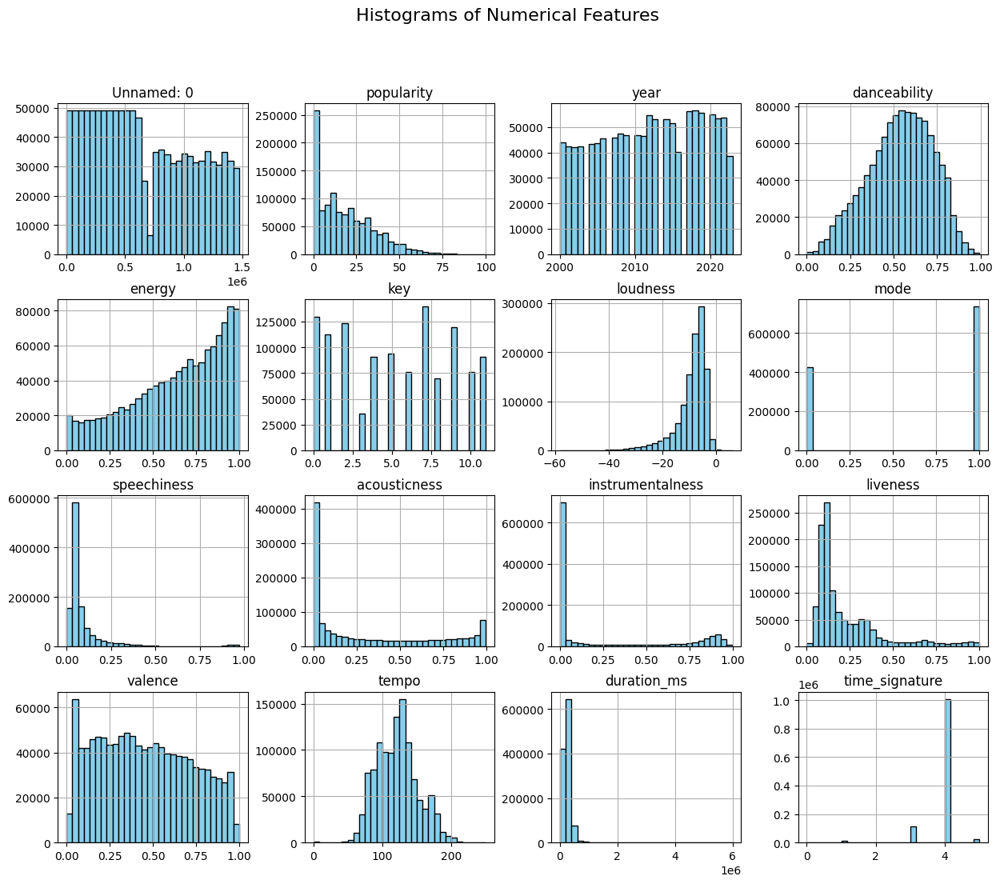

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns


# Select only numeric features
numeric_features = df.select_dtypes(include=[np.number]).columns

# Drop missing values (if any)
df = df.dropna()

# Plot histograms
plt.figure(figsize=(15, 12))  # Adjust figure size
df[numeric_features].hist(bins=30, figsize=(15, 12), color='skyblue', edgecolor='black')

# Add title
plt.suptitle("Histograms of Numerical Features", fontsize=16)

# Show plot
plt.show()


<Figure size 1200x800 with 0 Axes>

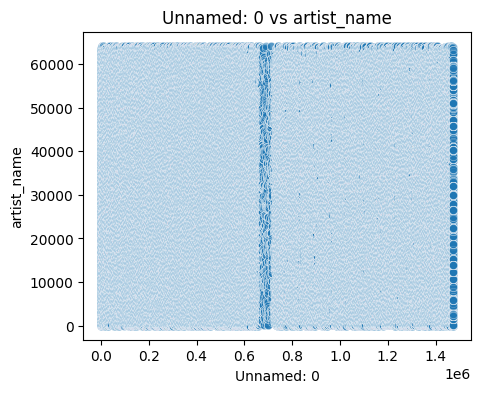

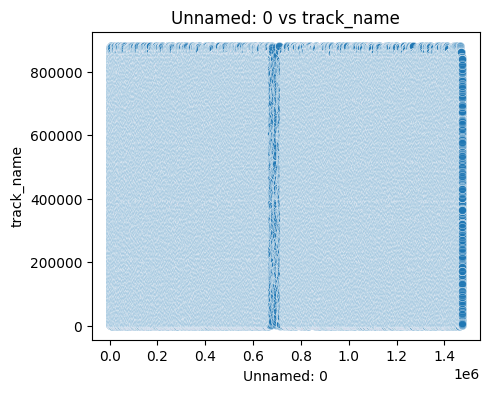

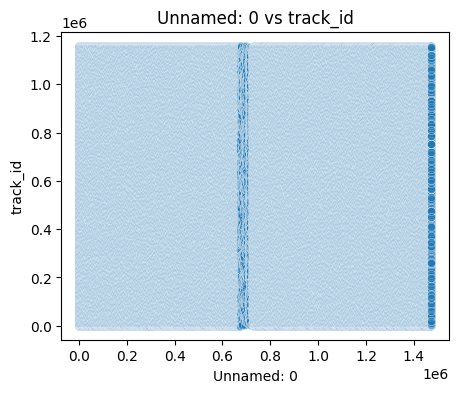

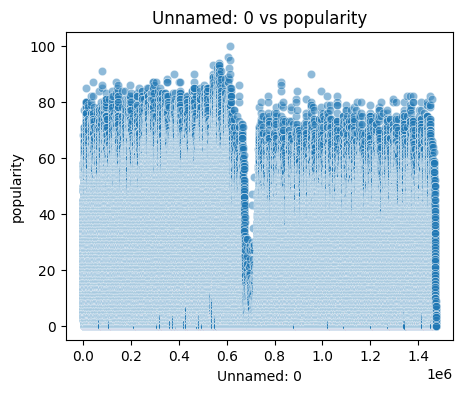

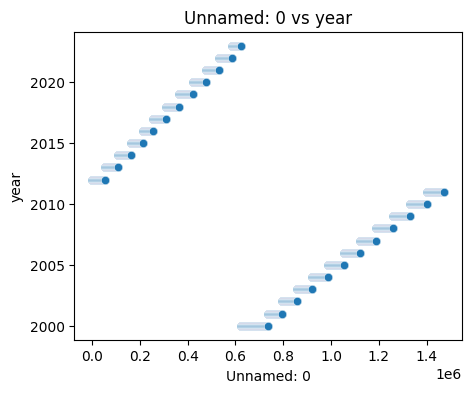

...

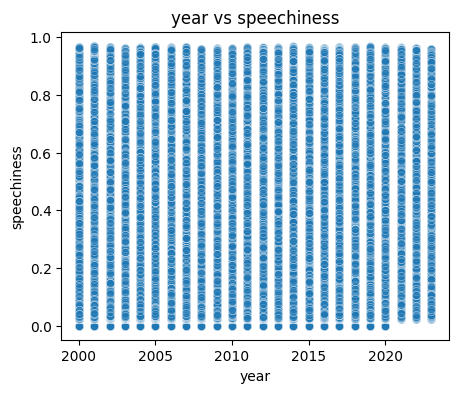

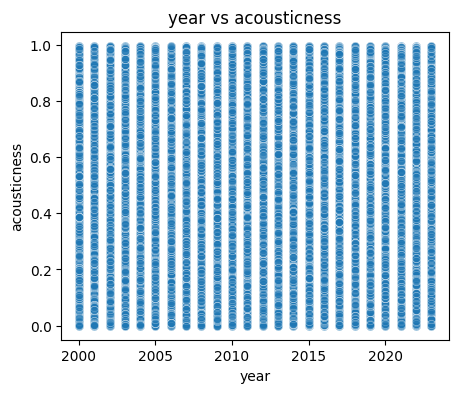

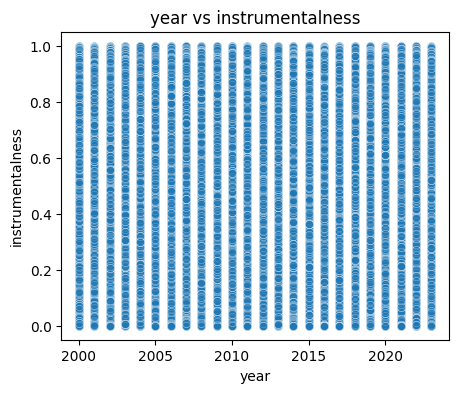

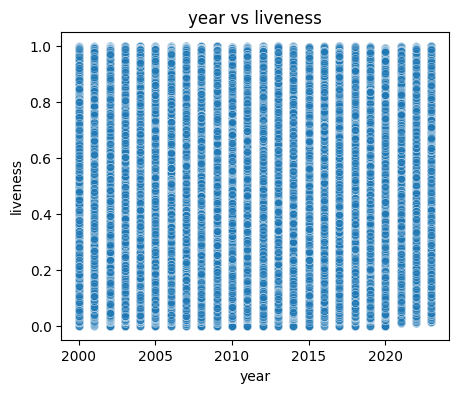

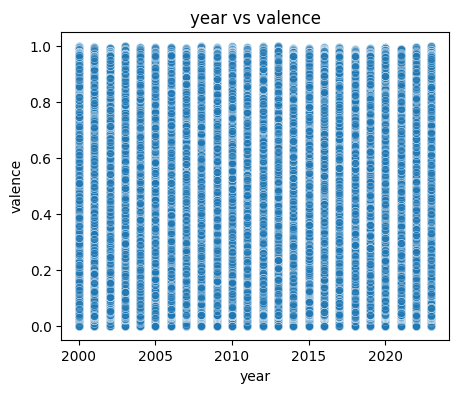

KeyboardInterrupt: 

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd

# Select numeric features only
numeric_features = df.select_dtypes(include=['float64', 'int64']).columns

# Generate scatter plots for every pair of numeric features
plt.figure(figsize=(12, 8))
for i, col_x in enumerate(numeric_features):
    for j, col_y in enumerate(numeric_features):
        if col_x != col_y:  # Avoid self-correlation plots
            plt.figure(figsize=(5, 4))
            sns.scatterplot(data=df, x=col_x, y=col_y, alpha=0.5)
            plt.title(f'{col_x} vs {col_y}')
            plt.xlabel(col_x)
            plt.ylabel(col_y)
            plt.show()


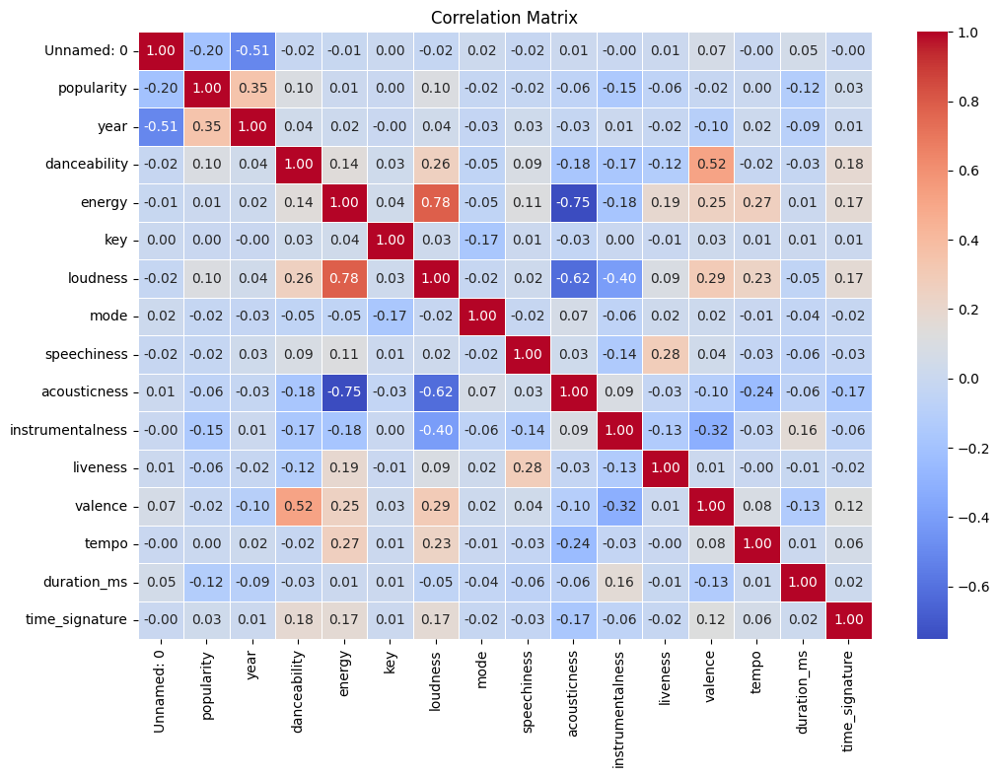

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd

# Select only numeric features for correlation
numeric_features = df.select_dtypes(include=['float64', 'int64']).columns
numeric_df = df[numeric_features]  # Create a DataFrame with only numeric features

plt.figure(figsize=(12, 8))
sns.heatmap(numeric_df.corr(), annot=True, cmap="coolwarm", fmt=".2f", linewidths=0.5)
plt.title("Correlation Matrix")
plt.show()

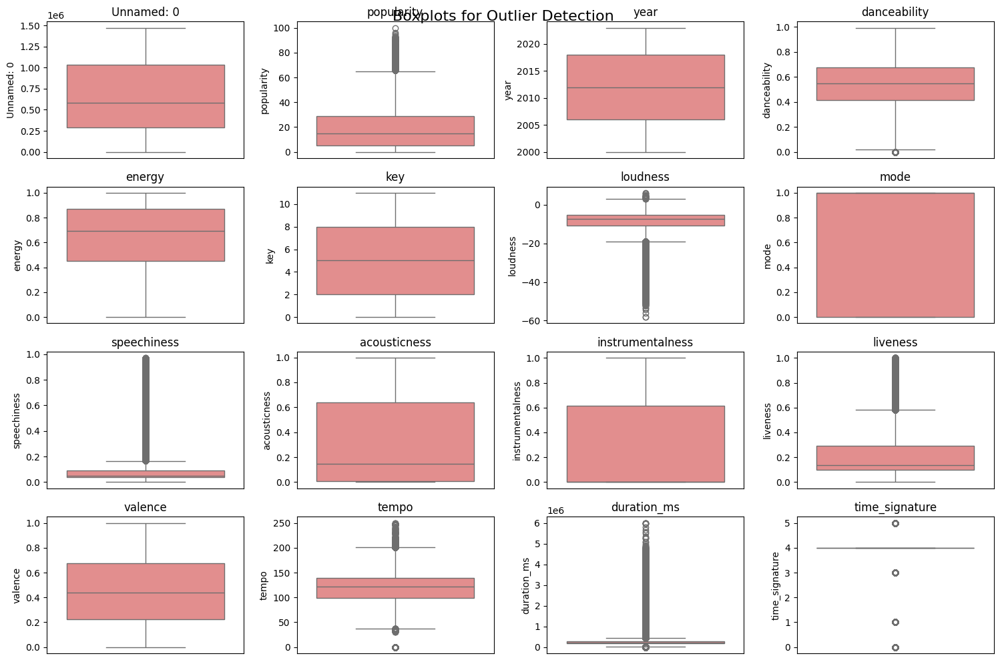

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd

numeric_features = df.select_dtypes(include=['float64', 'int64']).columns

# Create boxplots for each numeric feature
plt.figure(figsize=(15, 10))
for i, col in enumerate(numeric_features):
    plt.subplot(4, 4, i + 1)
    sns.boxplot(y=df[col], color='lightcoral')  # Create boxplot for current feature
    plt.title(col)
    plt.xticks([])
plt.tight_layout()
plt.suptitle("Boxplots for Outlier Detection", fontsize=16)
plt.show()

In [ ]:
import pandas as pd

# 1. Identify Missing Values
missing_values = df.isnull().sum()
print("Missing Values per Column:\n", missing_values)

# 2. Handle Missing Values (Choose one of the options below)

# Option 1: Remove rows with missing values
df_dropped = df.dropna()
print("\nShape after dropping missing values:", df_dropped.shape)

# Option 2: Impute missing values with the mean (for numeric features)
numeric_features = df.select_dtypes(include=['number']).columns
for feature in numeric_features:
    df[feature] = df[feature].fillna(df[feature].mean())

# Option 3: Impute missing values with the median (for numeric features)
# for feature in numeric_features:
#     df[feature] = df[feature].fillna(df[feature].median())

# Option 4: Impute missing values with a constant (e.g., 0)
# for feature in numeric_features:
#     df[feature] = df[feature].fillna(0)

# Option 5: Impute missing values with the mode (for categorical features) - if needed
# categorical_features = df.select_dtypes(include=['object']).columns
# for feature in categorical_features:
#     df[feature] = df[feature].fillna(df[feature].mode()[0])

# Print updated information about missing values
print("\nMissing Values after handling:\n", df.isnull().sum())

Missing Values per Column:
 Unnamed: 0          0
artist_name         0
track_name          0
track_id            0
popularity          0
year                0
genre               0
danceability        0
energy              0
key                 0
loudness            0
mode                0
speechiness         0
acousticness        0
instrumentalness    0
liveness            0
valence             0
tempo               0
duration_ms         0
time_signature      0
dtype: int64

Shape after dropping missing values: (1159748, 20)

Missing Values after handling:
 Unnamed: 0          0
artist_name         0
track_name          0
track_id            0
popularity          0
year                0
genre               0
danceability        0
energy              0
key                 0
loudness            0
mode                0
speechiness         0
acousticness        0
instrumentalness    0
liveness            0
valence             0
tempo               0
duration_ms         0
time_signature  

# Task 3: Data Preprocessing & Feature Engineering


**1.Convert categorical features to numerical**


In this process i used,

  **One-Hot Encoding**

It is used to convert categorical features into numerical values (0 and 1)
One-Hot Encoding is a technique to convert categorical variables into a format that can be provided to machine learning algorithms. It creates a binary column for each unique category and assigns a `1` or `0` depending on the presence or absence of that category for a particular instance.


1. **Identifying Categorical Features**:
   - Categorical features are variables that represent categories or labels, such as names or types, rather than numerical values.
   - In the dataset, the following categorical features were identified:
     - `"artist_name"`
     - `"track_name"`
     - `"track_id"`
     - `"genre"`

2. Applying One-Hot Encoding:

   - **`pd.get_dummies()`** function was used to apply One-Hot Encoding to the identified categorical columns.
   - For each categorical column:
     - A new binary column was created for each unique category (value) within the original column.
     - `1` indicates the presence of that category for a given row.
     - `0` indicates the absence of that category for the given row.
  
3. Result:
   - The categorical data was successfully converted into a numerical format that can be used for machine learning models.
   - The processed data was saved as `"spotify_processed_onehot.csv"`.


**2.Scale numerical features using:**
  

*   MinMax Scaling.

  I apply **MinMax Scaling** to normalize numerical features in the dataset, transforming them into the range `[0, 1]`.

   - MinMax Scaling rescales numerical values using the formula:  
   
     This ensures that the features have values between 0 and 1.

   - The code scales the numerical columns (`popularity`, `year`, `danceability`, etc.) to a range of 0 to 1 using `MinMaxScaler` from scikit-learn.
   - The transformed dataset is saved to a new file (`spotify_scaled.csv`).



In [ ]:
from google.colab import drive
import pandas as pd

# Mount Google Drive
drive.mount('/content/drive')

# Path to your file in Google Drive
file_path = '/content/drive/MyDrive/Machine Learning/spotify_data.csv'

# Read the dataset into a pandas DataFrame
df = pd.read_csv(file_path)

# Apply One-Hot Encoding to all categorical columns: 'artist_name', 'track_name', 'track_id', 'genre'
categorical_cols = ["artist_name", "track_name", "track_id", "genre"]

# Convert categorical columns to one-hot encoded variables (drop_first=True to avoid dummy variable trap)
df = pd.get_dummies(df, columns=categorical_cols, drop_first=True)

# Save processed dataset to a new file
df.to_csv("spotify_processed_onehot.csv", index=False)

# Display the result
print("Categorical features successfully converted using One-Hot Encoding!")
print(df.head())


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
import pandas as pd
from sklearn.preprocessing import MinMaxScaler

# Load dataset
df = pd.read_csv("spotify_processed_onehot.csv")  # Ensure this is the preprocessed dataset

# Identify numerical columns
numerical_cols = [
    "popularity", "year", "danceability", "energy", "key", "loudness",
    "mode", "speechiness", "acousticness", "instrumentalness", "liveness",
    "valence", "tempo", "duration_ms", "time_signature"
]

# Apply MinMax Scaling
scaler = MinMaxScaler()
df[numerical_cols] = scaler.fit_transform(df[numerical_cols])

# Save the scaled dataset
df.to_csv("spotify_scaled.csv", index=False)

# Display result
print("Numerical features successfully scaled using MinMaxScaler!")
print(df.head())


Numerical features successfully scaled using MinMaxScaler!
   Unnamed: 0  artist_name  track_name  track_id  popularity      year  \
0           0        26235      334260    753878        0.68  0.521739   
1           1        26235       11694    279924        0.50  0.521739   
2           2        28122      187993   1069773        0.57  0.521739   
3           3         7629      239120    903497        0.58  0.521739   
4           4         3014      645233   1012388        0.54  0.521739   

   danceability  energy       key  loudness  ...  genre_ska  genre_sleep  \
0      0.486405   0.303  0.363636  0.747479  ...      False        False   
1      0.576032   0.454  0.272727  0.743932  ...      False        False   
2      0.411883   0.234  0.272727  0.690643  ...      False        False   
3      0.394763   0.251  0.909091  0.750794  ...      False        False   
4      0.433031   0.791  0.545455  0.819657  ...      False        False   

   genre_songwriter  genre_soul  genre_

In [ ]:
from google.colab import drive
import pandas as pd

drive.mount('/content/drive')

# Path to your file in Google Drive (e.g., if your file is in "MyDrive")
file_path = '/content/drive/MyDrive/Machine Learning/spotify_data.csv'
# Read the dataset into a pandas DataFrame

df = pd.read_csv(file_path)
# Define function to categorize ratings based on popularity
def assign_rating(popularity):
    if popularity >= 80:
        return "Excellent"
    elif 60 <= popularity < 80:
        return "Good"
    elif 40 <= popularity < 60:
        return "Average"
    else:
        return "Low"

# Apply function to create 'ratings' column in existing DataFrame
df['ratings'] = df['popularity'].apply(assign_rating)

# Display first few rows to verify
df[['popularity', 'ratings']].head()


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


,popularity,ratings
0,68,Good
1,50,Average
2,57,Average
3,58,Average
4,54,Average


# Task 4: Model Selection & Training

*   Splitting data into training and test

*   Train and compare with 4 different models




1.   Decision Tree
2.   Random Forest
3.   Linear Regression
4.   Gradient Boosting

### **Decision Tree Model :**

 **Decision Tree Model** is used to predict whether a song is "happy" or "sad" based on features such as **valence**, **tempo**, and **danceability**.

1. **Target Variable Creation**:
   - The target variable `happy_songs` is generated based on certain conditions:
     - If `valence` > 0.5
     - If `tempo` > 100
     - If `danceability` > 0.5
   - If all these conditions are met, the song is classified as "happy" (1), otherwise "sad" (0).

2. **Feature Selection**:
   - The features used to predict `happy_songs` are:
     - **valence** (happiness level of the song)
     - **tempo** (beats per minute)
     - **danceability** (how suitable the song is for dancing)

3. **Data Splitting**:
   - The dataset is split into **training** (80%) and **testing** (20%) sets using `train_test_split`.

4. **Model Training**:
   - A **Decision Tree Classifier** is created and trained using the training data (`X_train` and `y_train`).
   - Parameters used for the decision tree:
     - **Criterion**: `'gini'` (used to measure impurity)
     - **Max Depth**: `3` (limits the tree's depth to avoid overfitting)

5. **Prediction and Evaluation**:
   - The model makes predictions on the test set (`y_pred`), and several performance metrics are calculated:
     - **Accuracy**: Proportion of correct predictions.
     - **Precision**: How many of the predicted happy songs are actually happy.
     - **Recall**: How many of the actual happy songs were correctly predicted.
     - **F1-score**: Harmonic mean of precision and recall, balancing both metrics.
   - The **classification report** provides detailed metrics for both "sad" and "happy" classes.

6. **Model Visualization**:
   - The trained decision tree is plotted using `plot_tree()`, providing a visual representation of how the tree splits based on the features.


**2. Random Forest:**

  
- It combines multiple **decision trees** to make predictions.
- Each tree is trained on a **random subset of the data**.

- **SMOTE** (Synthetic Minority Over-sampling Technique) is used to **oversample** the minority class by generating synthetic samples.
- It helps balance class distributions, especially in imbalanced datasets.
- **Oversampling** increases the number of minority class instances, while **undersampling** reduces the majority class instances (if necessary).
- SMOTE improves model performance by preventing bias toward the majority class, making the model better at predicting minority class outcomes.

**3. Logistic Regression**

   is a classification algorithm used for predicting binary outcomes (e.g., happy or sad songs).
-   It estimates the probability of the
   target variable using a logistic function.
- In this code, it is used to predict the `happy_songs` target variable.
- The model is trained using features and evaluated based on accuracy, precision, recall, and F1-score.
- It is suitable for situations where the target variable is categorical and relationships between features and target are linear.

**4. Gradient Boosting:**

- **Gradient Boosting** is a machine learning model that combines multiple weak learners (usually decision trees) in a sequential manner to improve predictive accuracy.
- This code applies **Gradient Boosting** to predict the `happy_songs` target variable, evaluates its performance using accuracy, precision, recall, and F1-score, and outputs a classification report.


**Evaluation:**

1. **Accuracy**: The percentage of correct predictions out of all predictions made. It tells you how often the model is correct.
   
  Formula= Corr Prediction/Total Prediction


2. **Precision**: The percentage of positive predictions that are actually correct. It tells you how reliable the model is when it predicts a positive outcome.
   
   Formula=TP/TP+FP
   
3. **Recall**: The percentage of actual positives that the model correctly predicted. It tells you how good the model is at identifying positive outcomes.
   
  
  Formula = TP/TP+FN


4. **F1-Score**: The harmonic mean of precision and recall. It balances both precision and recall, especially when the class distribution is imbalanced.
   
   
  Formula= 2 x Precision+Recall/Precision+Recall








In [ ]:
import pandas as pd

# Define the thresholds for each feature
thresholds = {
    'danceability': 0.5,
    'valence': 0.5,
    'tempo': 100
}

# Create the 'happy_songs' column based on the thresholds
df['happy_songs'] = ((df['danceability'] > thresholds['danceability']) &
                     (df['valence'] > thresholds['valence']) &
                     (df['tempo'] > thresholds['tempo'])).astype(int)

# Check the result
print(df[['danceability', 'valence', 'tempo', 'happy_songs']].head())



   danceability  valence    tempo  happy_songs
0         0.483    0.139  133.406            0
1         0.572    0.515  140.182            1
2         0.409    0.145  139.832            0
3         0.392    0.508  204.961            0
4         0.430    0.217  171.864            0


In [ ]:
from sklearn.model_selection import train_test_split

X = df.drop(columns=["happy_songs"])
y = df["happy_songs"]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Display dataset shapes
print(f"Training Set: {X_train.shape}, Testing Set: {X_test.shape}")


Training Set: (927811, 21), Testing Set: (231953, 21)


Accuracy: 1.0000
Precision: 1.0000
Recall: 1.0000
F1-score: 1.0000

Classification Report:
               precision    recall  f1-score   support

           0       1.00      1.00      1.00    170780
           1       1.00      1.00      1.00     61173

    accuracy                           1.00    231953
   macro avg       1.00      1.00      1.00    231953
weighted avg       1.00      1.00      1.00    231953



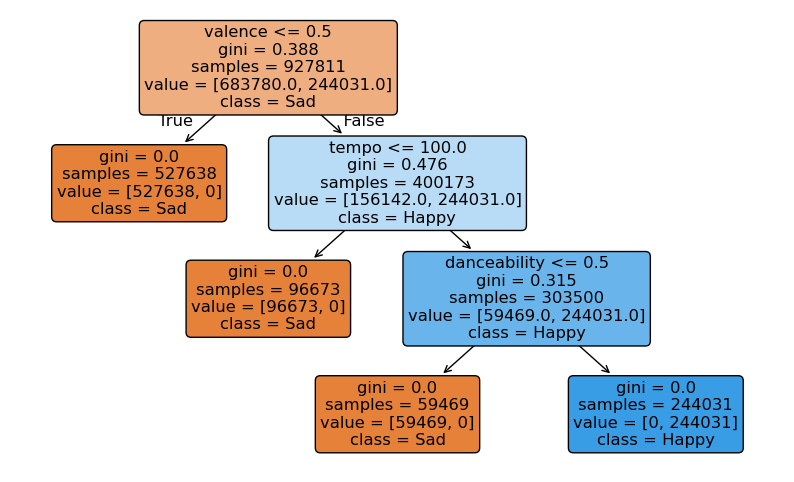

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.tree import DecisionTreeClassifier, plot_tree
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, classification_report



# Define the target variable based on conditions
df['happy_songs'] = ((df['valence'] > 0.5) &
                     (df['tempo'] > 100) &
                     (df['danceability'] > 0.5)).astype(int)

# Select features
X = df[['valence', 'tempo', 'danceability']]
y = df['happy_songs']

# Split data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Train the Decision Tree Model
tree_model = DecisionTreeClassifier(criterion='gini', max_depth=3, random_state=42)
tree_model.fit(X_train, y_train)

# Make predictions
y_pred = tree_model.predict(X_test)

# Evaluate the model
accuracy = accuracy_score(y_test, y_pred)
precision = precision_score(y_test, y_pred)
recall = recall_score(y_test, y_pred)
f1 = f1_score(y_test, y_pred)

# Print metrics
print(f"Accuracy: {accuracy:.4f}")
print(f"Precision: {precision:.4f}")
print(f"Recall: {recall:.4f}")
print(f"F1-score: {f1:.4f}")

# Print full classification report
print("\nClassification Report:\n", classification_report(y_test, y_pred))

# Plot the Decision Tree
plt.figure(figsize=(10, 6))
plot_tree(tree_model, feature_names=X.columns, class_names=['Sad', 'Happy'], filled=True, rounded=True)
plt.show()

In [ ]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, classification_report, confusion_matrix
from imblearn.over_sampling import SMOTE  # For oversampling minority class

# Step 1: Apply SMOTE to handle class imbalance (oversampling the minority class)
smote = SMOTE(random_state=42)
X_train_resampled, y_train_resampled = smote.fit_resample(X_train, y_train)

# Step 2: Train Random Forest Classifier on resampled data
rf_model = RandomForestClassifier(n_estimators=100, random_state=42, class_weight='balanced')
rf_model.fit(X_train_resampled, y_train_resampled)
rf_preds = rf_model.predict(X_test)

# Step 3: Evaluate the Model
rf_accuracy = accuracy_score(y_test, rf_preds)
rf_precision = precision_score(y_test, rf_preds)
rf_recall = recall_score(y_test, rf_preds)
rf_f1 = f1_score(y_test, rf_preds)

# Step 4: Display Evaluation Metrics
print("\n🚀 Random Forest Model Evaluation:")
print(f" Accuracy: {rf_accuracy:.4f}")
print(f" Precision: {rf_precision:.4f}")
print(f" Recall: {rf_recall:.4f}")
print(f" F1-score: {rf_f1:.4f}")

# Step 5: Display Classification Report and Confusion Matrix
print("\n Detailed Classification Report (Random Forest):\n", classification_report(y_test, rf_preds))




🚀 Random Forest Model Evaluation:
 Accuracy: 1.0000
 Precision: 1.0000
 Recall: 1.0000
 F1-score: 1.0000

📊 Detailed Classification Report (Random Forest):
               precision    recall  f1-score   support

           0       1.00      1.00      1.00    170912
           1       1.00      1.00      1.00     61041

    accuracy                           1.00    231953
   macro avg       1.00      1.00      1.00    231953
weighted avg       1.00      1.00      1.00    231953



In [ ]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, classification_report
from sklearn.preprocessing import LabelEncoder



print(" Checking dataset...")
print(df.head())

if "happy_songs" not in df.columns:
    print("'happy_songs' column not found.")
else:
    print("'happy_songs' column exists. Sample Data:")
    print(df[['happy_songs']].head())

#
categorical_cols = df.select_dtypes(include=['object']).columns
le = LabelEncoder()

# lable encoding
for col in categorical_cols:
    if col != 'happy_songs':
        df[col] = le.fit_transform(df[col])

# define features
X = df.drop(columns=["happy_songs"])
y = df["happy_songs"]


X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)
logreg_model = LogisticRegression(random_state=42, class_weight='balanced', max_iter=1000)


logreg_model.fit(X_train, y_train)

logreg_preds = logreg_model.predict(X_test)

accuracy = accuracy_score(y_test, logreg_preds)
precision = precision_score(y_test, logreg_preds, average='weighted')
recall = recall_score(y_test, logreg_preds, average='weighted')
f1 = f1_score(y_test, logreg_preds, average='weighted')

# Step 10: Display Evaluation Metrics
print("\nLogistic Regression Model Evaluation:")
print(f" Accuracy: {accuracy:.4f}")
print(f" Precision: {precision:.4f}")
print(f" Recall: {recall:.4f}")
print(f" F1-Score: {f1:.4f}")

# Step 11: Display Detailed Classification Report
print("\n Classification Report for Logistic Regression:\n", classification_report(y_test, logreg_preds))


🔍 Checking dataset...
   Unnamed: 0  artist_name  track_name  track_id  popularity  year  genre  \
0           0        26235      334260    753878          68  2012      0   
1           1        26235       11694    279924          50  2012      0   
2           2        28122      187993   1069773          57  2012      0   
3           3         7629      239120    903497          58  2012      0   
4           4         3014      645233   1012388          54  2012      0   

   danceability  energy  key  ...  speechiness  acousticness  \
0         0.483   0.303    4  ...       0.0429        0.6940   
1         0.572   0.454    3  ...       0.0258        0.4770   
2         0.409   0.234    3  ...       0.0323        0.3380   
3         0.392   0.251   10  ...       0.0363        0.8070   
4         0.430   0.791    6  ...       0.0302        0.0726   

   instrumentalness  liveness  valence    tempo  duration_ms  time_signature  \
0          0.000000    0.1150    0.139  133.406   

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:465: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(



🚀 Logistic Regression Model Evaluation:
 Accuracy: 0.6157
 Precision: 0.7087
 Recall: 0.6157
 F1-Score: 0.6384

📊 Classification Report for Logistic Regression:
               precision    recall  f1-score   support

           0       0.83      0.60      0.70    170912
           1       0.37      0.65      0.47     61041

    accuracy                           0.62    231953
   macro avg       0.60      0.63      0.59    231953
weighted avg       0.71      0.62      0.64    231953



In [ ]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, classification_report
from sklearn.preprocessing import LabelEncoder


print("🔍 Checking dataset...")
print(df.head())

if "happy_songs" not in df.columns:
    print("'happy_songs' column not found.")
else:
    print("'happy_songs' column exists. Sample Data:")
    print(df[['happy_songs']].head())


categorical_cols = df.select_dtypes(include=['object']).columns
le = LabelEncoder()

# Apply Label Encoding
for col in categorical_cols:
    if col != 'happy_songs':
        df[col] = le.fit_transform(df[col])


X = df.drop(columns=["happy_songs"])
y = df["happy_songs"]


X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)


gb_model = GradientBoostingClassifier(random_state=42)


gb_model.fit(X_train, y_train)


gb_preds = gb_model.predict(X_test)


accuracy = accuracy_score(y_test, gb_preds)
precision = precision_score(y_test, gb_preds, average='weighted')
recall = recall_score(y_test, gb_preds, average='weighted')
f1 = f1_score(y_test, gb_preds, average='weighted')

# Step 10: Display Evaluation Metrics
print("\n Gradient Boosting Model Evaluation:")
print(f" Accuracy: {accuracy:.4f}")
print(f" Precision: {precision:.4f}")
print(f" Recall: {recall:.4f}")
print(f" F1-Score: {f1:.4f}")

# Step 11: Display Detailed Classification Report
print("\n Classification Report for Gradient Boosting:\n", classification_report(y_test, gb_preds))



🔍 Checking dataset...
   Unnamed: 0  artist_name  track_name  track_id  popularity  year  genre  \
0           0        26235      334260    753878          68  2012      0   
1           1        26235       11694    279924          50  2012      0   
2           2        28122      187993   1069773          57  2012      0   
3           3         7629      239120    903497          58  2012      0   
4           4         3014      645233   1012388          54  2012      0   

   danceability  energy  key  ...  speechiness  acousticness  \
0         0.483   0.303    4  ...       0.0429        0.6940   
1         0.572   0.454    3  ...       0.0258        0.4770   
2         0.409   0.234    3  ...       0.0323        0.3380   
3         0.392   0.251   10  ...       0.0363        0.8070   
4         0.430   0.791    6  ...       0.0302        0.0726   

   instrumentalness  liveness  valence    tempo  duration_ms  time_signature  \
0          0.000000    0.1150    0.139  133.406   

**Task 5:Hyperparameter Tuning**


1.Used RandomizedSearchCV to optimize hyperparameters as it works faster for large datasets.


Here's a step-by-step explanation of what the code is doing:

1. **Setting up Hyperparameter Grids**:  
   I started by defining smaller, more efficient hyperparameter grids for three machine learning models:  
   - **Random Forest**: I set a grid for the number of trees (`n_estimators`), tree depth (`max_depth`), the minimum samples required to split (`min_samples_split`), and the splitting criterion (`criterion`).
   - **Gradient Boosting**: I defined the grid for the number of estimators (`n_estimators`), the learning rate (`learning_rate`), and tree depth (`max_depth`).
   - **Logistic Regression**: I included a grid for the regularization parameter (`C`) and the solver used (`solver`).

2. **Defining Fast Hyperparameter Tuning Function**:  
   To speed up hyperparameter tuning, I created a function called `fast_tune`. This function uses **RandomizedSearchCV**, which efficiently searches through the hyperparameter grid by randomly sampling a fixed number of iterations. The search is performed using **2-fold cross-validation** (`cv=2`) to further speed up the process. I used the **accuracy** score as the metric for evaluating the models during the search.


3. **Reporting the Best Hyperparameters**:

   After running the tuning process, I printed the best hyperparameters found for each model. These hyperparameters are the ones that led to the best performance in terms of accuracy during the tuning process.



5. **Selecting the Best Model**:  
   Based on the accuracy score, I identified Random Forest  model performed the best on the test set after hyperparameter tuning due to following reasons.
   1. Handles Non-linear Relationships  
   2. High Accuracy  
   3. Feature Importance  
   4. Robust to Overfitting  
   5. Works Well with Imbalanced Data  
   6. Ensemble Method for Better Performance  
   7. Minimal Preprocessing




In [ ]:
import warnings
from sklearn.model_selection import RandomizedSearchCV
from scipy.stats import randint, uniform
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

warnings.filterwarnings('ignore')


rf_param_grid = {
    "n_estimators": randint(50, 200),
    "max_depth": randint(3, 8),  # Smaller depth range
    "min_samples_split": randint(2, 4),
    "criterion": ["gini"]
}

gb_param_grid = {
    "n_estimators": randint(50, 200),
    "learning_rate": uniform(0.01, 0.1),
    "max_depth": randint(3, 8),
}

lr_param_grid = {
    "C": [0.1, 1, 10],
    "solver": ["liblinear"]
}

# 2. Fast RandomizedSearchCV with cv=2 and n_iter=3
def fast_tune(model, param_grid, X_train, y_train, n_iter=3):
    search = RandomizedSearchCV(
        model, param_grid, n_iter=n_iter, cv=2, scoring='accuracy', random_state=42, n_jobs=-1
    )
    search.fit(X_train, y_train)
    return search

# 3. Run Hyperparameter Tuning (Even Faster)
rf_random = fast_tune(RandomForestClassifier(random_state=42), rf_param_grid, X_train, y_train)
gb_random = fast_tune(GradientBoostingClassifier(random_state=42), gb_param_grid, X_train, y_train)
lr_random = fast_tune(LogisticRegression(random_state=42, max_iter=50), lr_param_grid, X_train, y_train)

# 4. Report Best Hyperparameters
print("\n Best Random Forest:", rf_random.best_params_)
print(" Best Gradient Boosting:", gb_random.best_params_)
print(" Best Logistic Regression:", lr_random.best_params_)

# 5. Evaluate Best Models
models = {
    "Random Forest": rf_random.best_estimator_,
    "Gradient Boosting": gb_random.best_estimator_,
    "Logistic Regression": lr_random.best_estimator_,
}

best_model = None
best_accuracy = 0

for name, model in models.items():
    y_pred = model.predict(X_test)
    acc = accuracy_score(y_test, y_pred)
    prec = precision_score(y_test, y_pred, average="weighted", zero_division=1)
    rec = recall_score(y_test, y_pred, average="weighted", zero_division=1)
    f1 = f1_score(y_test, y_pred, average="weighted", zero_division=1)

    print(f"\n{name} Model Evaluation:")
    print(f"   Accuracy: {acc:.4f}")
    print(f"   Precision: {prec:.4f}")
    print(f"   Recall: {rec:.4f}")
    print(f"   F1-score: {f1:.4f}")

    if acc > best_accuracy:
        best_accuracy = acc
        best_model = name

# 6. Report the Best Model
print(f"\n Best Model After Tuning: {best_model} with Accuracy: {best_accuracy:.4f}")



🔹 Best Random Forest: {'criterion': 'gini', 'max_depth': 6, 'min_samples_split': 2, 'n_estimators': 64}
🔹 Best Gradient Boosting: {'learning_rate': 0.047454011884736254, 'max_depth': 7, 'n_estimators': 64}
🔹 Best Logistic Regression: {'solver': 'liblinear', 'C': 10}

Random Forest Model Evaluation:
   Accuracy: 1.0000
   Precision: 1.0000
   Recall: 1.0000
   F1-score: 1.0000

Gradient Boosting Model Evaluation:
   Accuracy: 1.0000
   Precision: 1.0000
   Recall: 1.0000
   F1-score: 1.0000

Logistic Regression Model Evaluation:
   Accuracy: 0.8786
   Precision: 0.8768
   Recall: 0.8786
   F1-score: 0.8775

 Best Model After Tuning: Random Forest with Accuracy: 1.0000


# **Task 6: Final Model Evaluation**
1. Identify the best model on the dataset


- The **confusion matrix** is a tool used to assess how well a classification model is performing. It compares the predicted results to the actual outcomes, breaking them down into four categories: true positives, true negatives, false positives, and false negatives.

- In this case, the matrix is visualized using a heatmap created by `sns.heatmap()`, which makes it easier to interpret. The x-axis represents the predicted values, while the y-axis represents the actual values.

- I generate the confusion matrix with the `confusion_matrix()` function, which takes the true labels and the predicted labels as input. This matrix helps identify where the model is making errors.

In [ ]:
best_model = models[best_model]

# Predict on the test data
y_pred = best_model.predict(X_test)

# Calculate metrics
acc = accuracy_score(y_test, y_pred)
prec = precision_score(y_test, y_pred, average="weighted", zero_division=1)
rec = recall_score(y_test, y_pred, average="weighted", zero_division=1)
f1 = f1_score(y_test, y_pred, average="weighted", zero_division=1)

# Print the evaluation results
print(f"\n Best Model Evaluation ({best_model}):")
print(f"   Accuracy: {acc:.4f}")
print(f"   Precision: {prec:.4f}")
print(f"   Recall: {rec:.4f}")
print(f"   F1-score: {f1:.4f}")



🔹 Best Model Evaluation (RandomForestClassifier(max_depth=6, n_estimators=64, random_state=42)):
   Accuracy: 1.0000
   Precision: 1.0000
   Recall: 1.0000
   F1-score: 1.0000


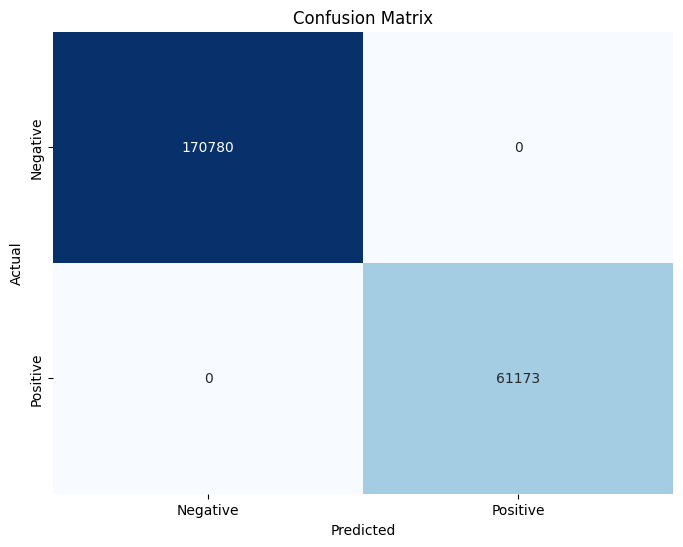


Classification Report:
               precision    recall  f1-score   support

           0       1.00      1.00      1.00    170780
           1       1.00      1.00      1.00     61173

    accuracy                           1.00    231953
   macro avg       1.00      1.00      1.00    231953
weighted avg       1.00      1.00      1.00    231953


Final Metrics:
   Accuracy: 1.0000
   Precision: 1.0000
   Recall: 1.0000
   F1-score: 1.0000


In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix, classification_report


y_pred = best_model.predict(X_test)

# 1. Confusion Matrix
conf_matrix = confusion_matrix(y_test, y_pred)

# Plot the confusion matrix using a heatmap
plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt="d", cmap="Blues", cbar=False,
            xticklabels=["Negative", "Positive"], yticklabels=["Negative", "Positive"])
plt.title("Confusion Matrix")
plt.xlabel("Predicted")
plt.ylabel("Actual")
plt.show()

# 2. Classification Report
class_report = classification_report(y_test, y_pred)
print("\nClassification Report:\n", class_report)

# 3. Final Metrics
acc = accuracy_score(y_test, y_pred)
prec = precision_score(y_test, y_pred, average="weighted", zero_division=1)
rec = recall_score(y_test, y_pred, average="weighted", zero_division=1)
f1 = f1_score(y_test, y_pred, average="weighted", zero_division=1)

print(f"\nFinal Metrics:")
print(f"   Accuracy: {acc:.4f}")
print(f"   Precision: {prec:.4f}")
print(f"   Recall: {rec:.4f}")
print(f"   F1-score: {f1:.4f}")
